<a href="https://colab.research.google.com/github/rsidorchuk93/multimodal/blob/main/image_to_text_photo_description.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image to text - photo description

In [7]:
import os

In [5]:
# Connect to Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install transformers -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 50.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.1/200.1 kB 18.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 55.4 MB/s eta 0:00:00


In [12]:
# read dataframe, parse listing dates
folder = '/content/drive/My Drive/test/photo_object_face_detection/'

In [13]:
os.listdir(folder)

['IMG_9687.jpg',
 'IMG_8940.JPG',
 'IMG_6853.jpg',
 'IMG_6422.jpg',
 '6 (1).jpg',
 'IMG-20191013-WA0001.jpg',
 'IMG_3160.jpg',
 'persons']

In [14]:
print(folder + 'IMG_6422.jpg')

/content/drive/My Drive/test/photo_object_face_detection/IMG_6422.jpg


In [35]:
from transformers import VisionEncoderDecoderModel, ViTImageProcessor, AutoTokenizer
import torch
from PIL import Image

model = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
feature_extractor = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

max_length = 16
num_beams = 4
gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
def predict_step(image_paths):
  images = []
  for image_path in image_paths:
    i_image = Image.open(image_path)
    if i_image.mode != "RGB":
      i_image = i_image.convert(mode="RGB")

    images.append(i_image)

  pixel_values = feature_extractor(images=images, return_tensors="pt").pixel_values
  pixel_values = pixel_values.to(device)

  output_ids = model.generate(pixel_values, **gen_kwargs)

  preds = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
  preds = [pred.strip() for pred in preds]
  return preds

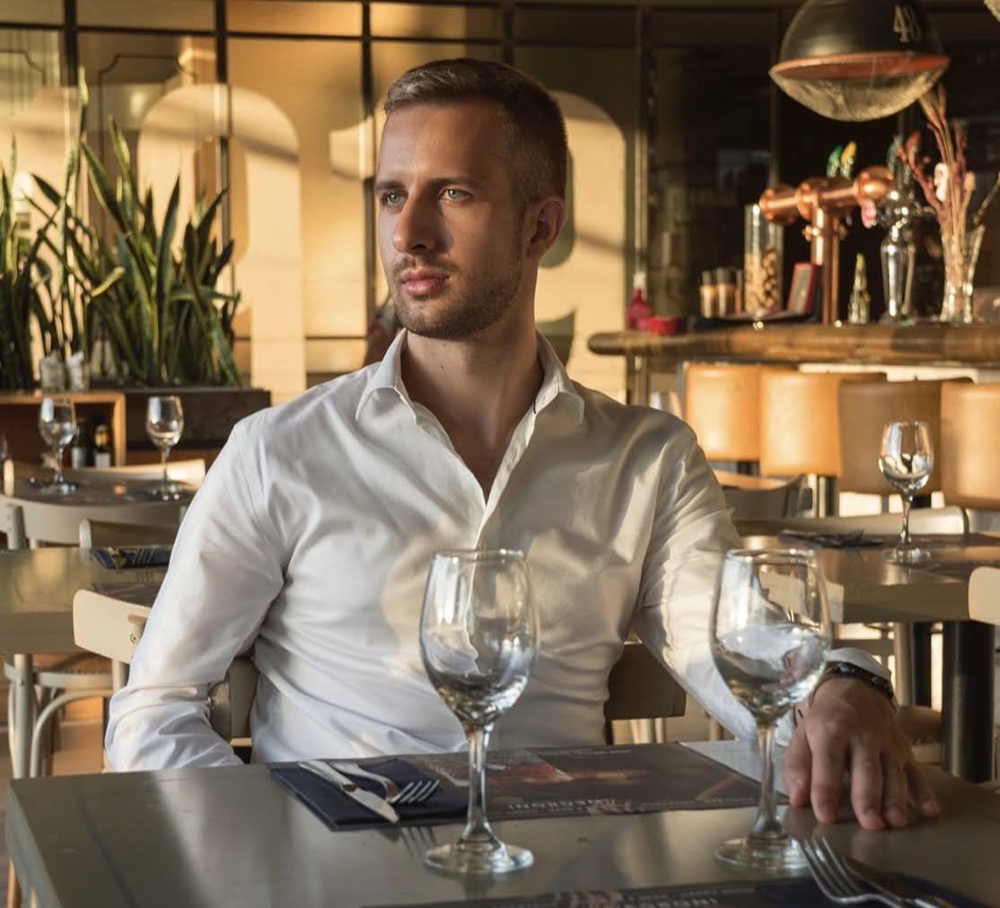

In [31]:
# Load the image from file
image = Image.open(folder + 'IMG_6422.jpg')

# Display the image
image.show()

In [42]:
predict_step(['/content/drive/My Drive/test/photo_object_face_detection/IMG_6422.jpg']) 

['a man sitting at a table with wine glasses']

In [41]:
image_paths = [os.path.join(folder, file_name) for file_name in files if file_name.endswith('.jpg') or file_name.endswith('.png')]

['a man sitting in a cockpit of a plane']


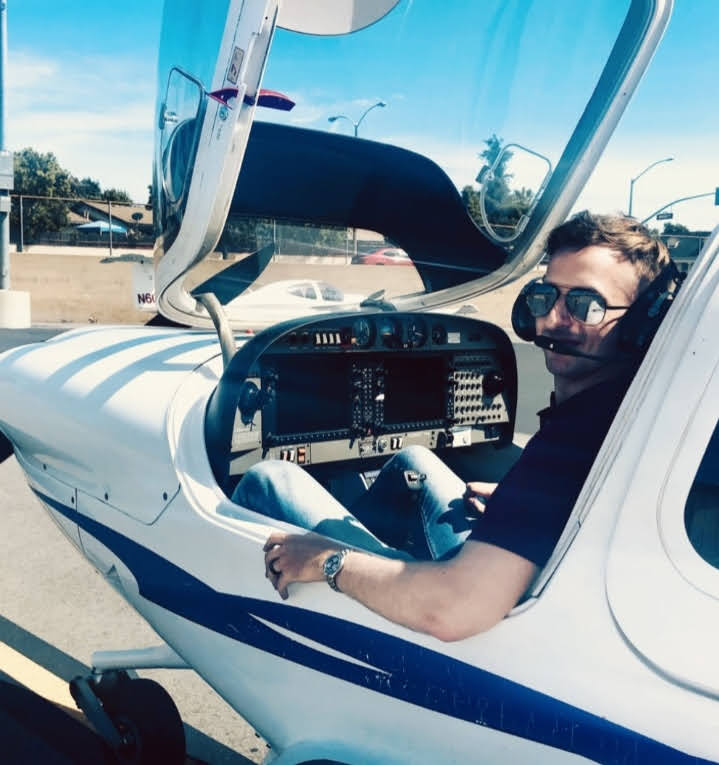

['a man holding a dog on top of a grass covered field']


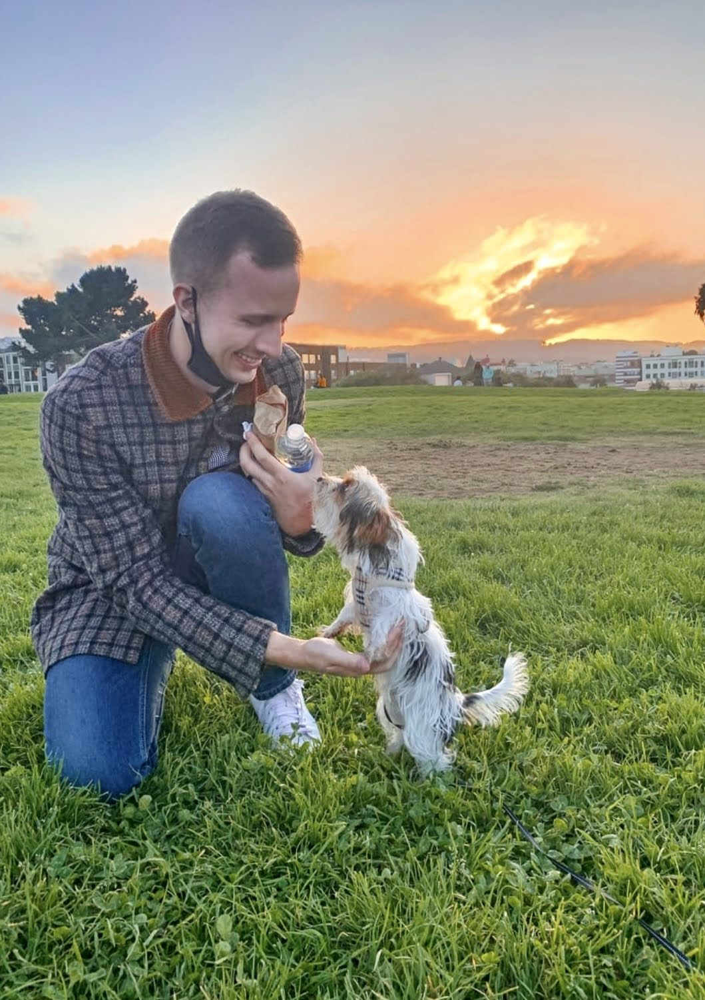

['a man sitting at a table with wine glasses']


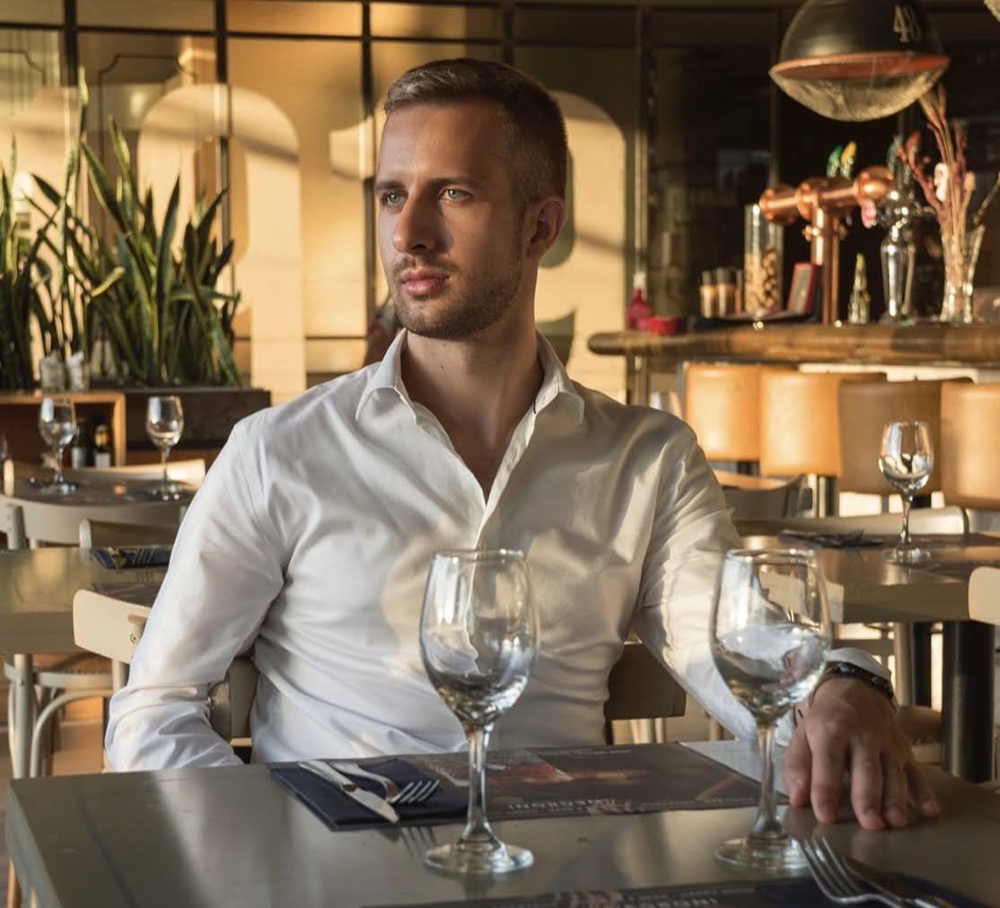

['a man sitting at a desk in front of a lamp']


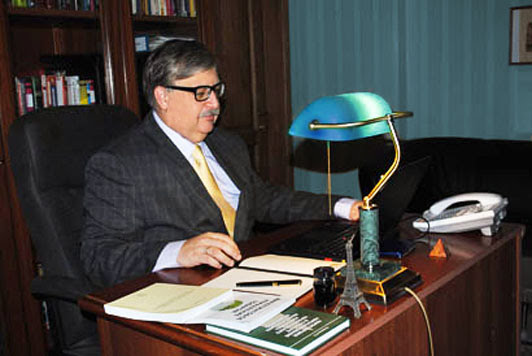

['a man and a woman posing for a picture']


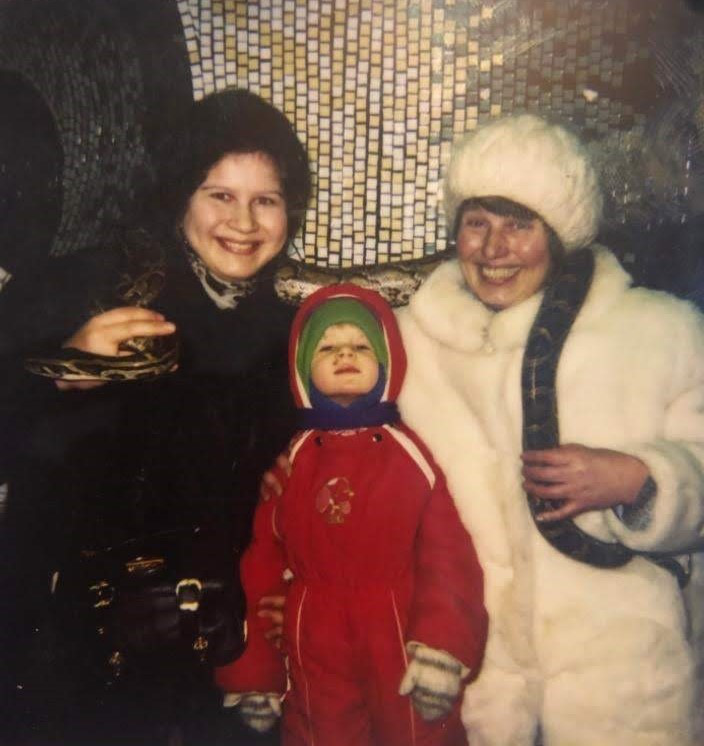

['men and women posing for a picture']


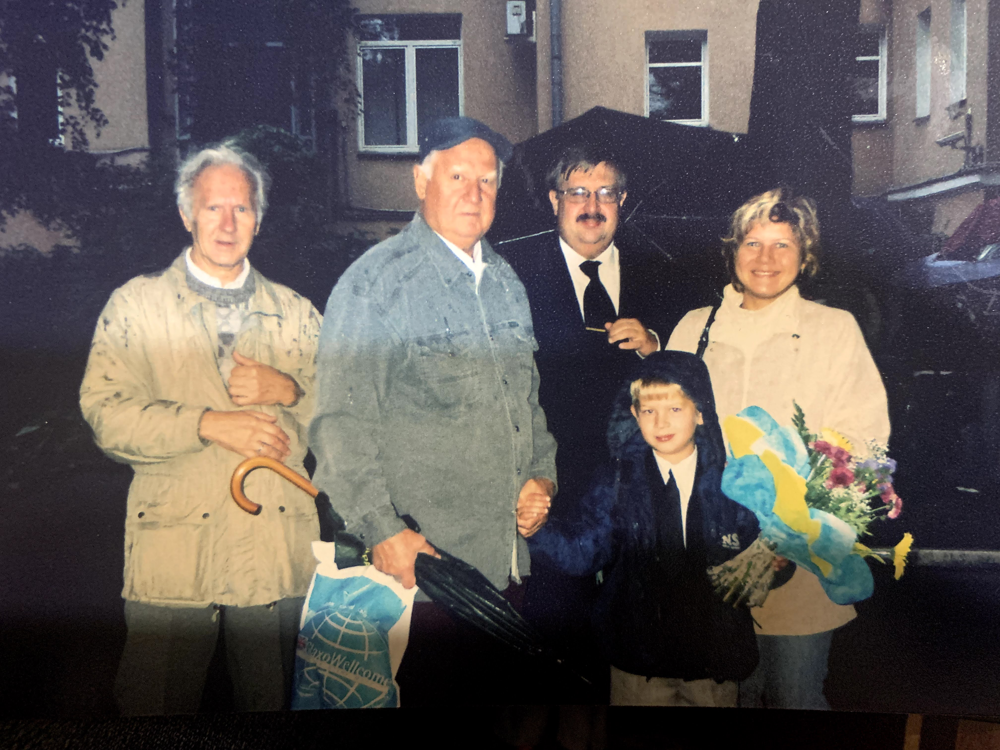

In [40]:
for image in image_paths:
  print(predict_step([image]))
  image = Image.open(image)
  # Display the image
  image.show()